In [2]:
from matplotlib import pyplot
from scipy.misc import toimage

In [3]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D
import keras
import tensorflow as tf

from keras.datasets import cifar10

Using TensorFlow backend.


In [4]:
config = tf.ConfigProto( device_count = {'GPU': 5 , 'CPU': 1} ) 
sess = tf.Session(config=config) 
keras.backend.set_session(sess)

In [23]:
from tensorflow.python.client import device_lib

print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 8469980127200553995
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 4622072166778814463
physical_device_desc: "device: XLA_CPU device"
]


In [24]:
def show_image_grid(X):
    pyplot.figure(1)
    k = 0
    for i in range(0, 3):
        for j in range(0, 3):
            pyplot.subplot2grid((3,3),(i,j))
            pyplot.imshow(toimage(X[k]))
            k = k + 1
    pyplot.show()

In [11]:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()

In [26]:
cats = [X_train[i] for i in range(0, len(X_train)) if y_train[i] == 3]

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  import sys


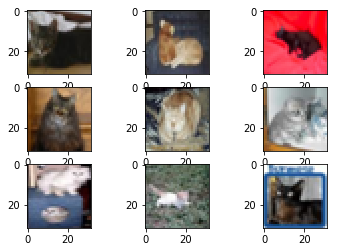

In [27]:
show_image_grid(cats)

In [28]:
num_classes=10

In [29]:
X_train.shape[1:]

(32, 32, 3)

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  """Entry point for launching an IPython kernel.


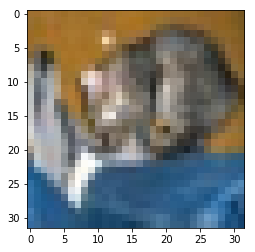

In [30]:
pyplot.imshow(toimage(X_test[0]))

In [31]:
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

model = Sequential()
model.add(Conv2D(32, (3, 3), padding='same',
                 input_shape=X_train.shape[1:]))
model.add(Activation('relu'))
model.add(Conv2D(32, (3, 3), padding='same',
                 input_shape=X_train.shape[1:]))
model.add(Activation('relu'))
model.add(Conv2D(32, (2, 2), padding='same',
                 input_shape=X_train.shape[1:]))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (2, 2), padding='same',
                 input_shape=X_train.shape[1:]))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(512))
model.add(Activation('relu'))
model.add(Dense(512))
model.add(Activation('relu'))
model.add(Dense(512))
model.add(Dense(num_classes))
model.add(Activation('softmax'))

In [32]:
sgd = keras.optimizers.SGD(lr=0.0001,
                           decay=1e-6,
                           momentum=0.9,
                           nesterov=True)
model.compile(loss='categorical_crossentropy',
              optimizer=sgd,
              metrics=['accuracy'])


In [33]:
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
X_train /= 255
X_test /= 255

In [34]:
X_val = X_train[0:500,:]
y_val = y_train[0:500,:]
X_train = X_train[501:,:]
y_train = y_train[501:,:]

In [35]:
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
datagen = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True)
datagen.fit(X_train)

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  import sys


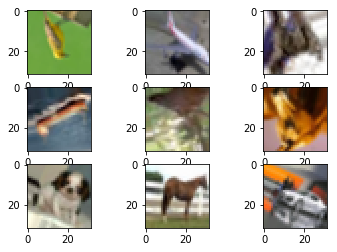

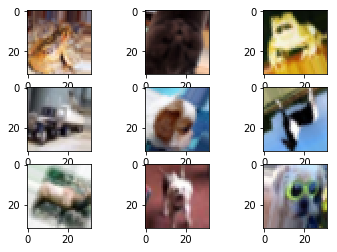

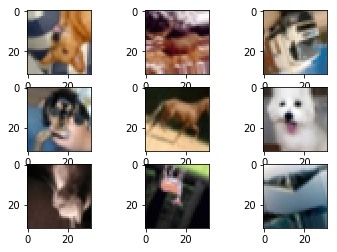

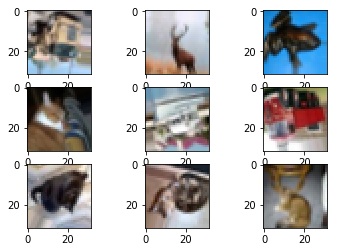

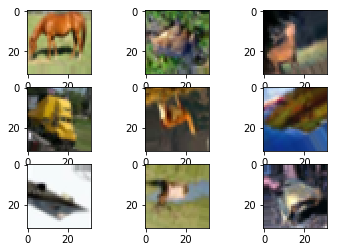

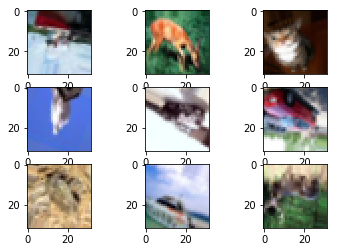

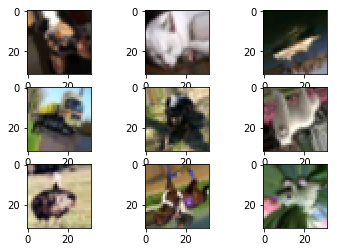

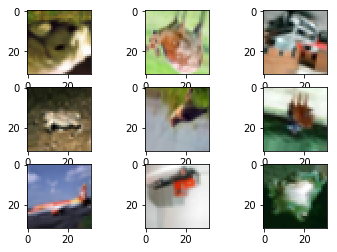

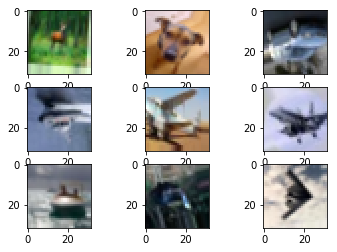

In [36]:
iterr = datagen.flow(X_train, y_train, batch_size=9)
for i in range(9):
    x, y = next(iterr)
    show_image_grid(x)

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  import sys


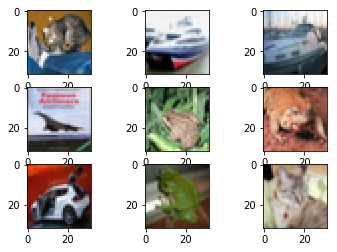

In [37]:
show_image_grid(X_test[:16])

In [38]:
model.fit(X_train,
          y_train,
          batch_size=32,
          epochs=10,
          validation_data=(X_val, y_val),
          shuffle=True)

Train on 49499 samples, validate on 500 samples
Epoch 1/10
49499/49499 [==============================] - 106s 2ms/step - loss: 2.2822 - acc: 0.1463 - val_loss: 2.2454 - val_acc: 0.1700
Epoch 2/10
49499/49499 [==============================] - 107s 2ms/step - loss: 2.1417 - acc: 0.2353 - val_loss: 2.0011 - val_acc: 0.2860
Epoch 3/10
49499/49499 [==============================] - 276s 6ms/step - loss: 1.9363 - acc: 0.3130 - val_loss: 1.8611 - val_acc: 0.3420
Epoch 4/10
49499/49499 [==============================] - 179s 4ms/step - loss: 1.8347 - acc: 0.3527 - val_loss: 1.7463 - val_acc: 0.3660
Epoch 5/10
49499/49499 [==============================] - 108s 2ms/step - loss: 1.7495 - acc: 0.3815 - val_loss: 1.6900 - val_acc: 0.3860
Epoch 6/10
49499/49499 [==============================] - 107s 2ms/step - loss: 1.6754 - acc: 0.4068 - val_loss: 1.6262 - val_acc: 0.4040
Epoch 7/10
49499/49499 [==============================] - 107s 2ms/step - loss: 1.6115 - acc: 0.4311 - val_loss: 1.5925 - va

In [39]:
scores = model.evaluate(X_test,
                        y_test,
                        verbose=1)
print('Test loss:', scores[0])
print('Test accuracy:', scores[1])

10000/10000 [==============================] - 5s 506us/step
Test loss: 1.4556747383117676
Test accuracy: 0.4778


In [40]:
scores

[1.4556747383117676, 0.4778]

In [41]:
predicted = model.predict(X_test)

In [42]:
import numpy as np

In [43]:
predicted

array([[1.13057392e-02, 4.32546623e-03, 5.51455580e-02, ...,
        5.50431572e-03, 5.47846183e-02, 4.11742833e-03],
       [8.39784518e-02, 4.57254678e-01, 5.58751984e-04, ...,
        6.44532673e-04, 2.29686394e-01, 2.25720689e-01],
       [1.33349106e-01, 1.04234874e-01, 9.59954876e-03, ...,
        5.66541450e-03, 5.14850318e-01, 2.09750682e-01],
       ...,
       [5.80078398e-04, 4.82534306e-05, 1.23354003e-01, ...,
        4.74634953e-02, 2.04513618e-03, 5.22903400e-04],
       [5.63979000e-02, 1.64676029e-02, 3.36135440e-02, ...,
        2.31503025e-02, 3.83173265e-02, 1.86371282e-02],
       [1.30374143e-02, 2.67211720e-03, 8.45191106e-02, ...,
        5.54131448e-01, 3.60559393e-03, 1.22631751e-02]], dtype=float32)

In [44]:
predicted[0]

array([0.01130574, 0.00432547, 0.05514556, 0.39625725, 0.03584692,
       0.2888803 , 0.14383252, 0.00550432, 0.05478462, 0.00411743],
      dtype=float32)

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  import sys


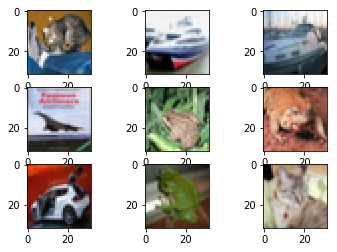

In [45]:
show_image_grid(X_test[0:25,:])

In [46]:
y_test[0]

array([0., 0., 0., 1., 0., 0., 0., 0., 0., 0.], dtype=float32)

In [47]:
y_train[0]

array([0., 0., 0., 0., 0., 0., 0., 0., 1., 0.], dtype=float32)

In [48]:
keras.utils.to_categorical(np.r_[0, 1], num_classes=2)

array([[1., 0.],
       [0., 1.]], dtype=float32)

In [48]:
cnt = [0] * 10
for k in range(len(X_val)):
    cnt[y_val[k][0]] += 1
print(cnt)

[51, 65, 43, 47, 50, 40, 53, 50, 45, 56]


In [45]:
len(X_train)

49499

In [47]:
y_val

array([[6],
       [9],
       [9],
       [4],
       [1],
       [1],
       [2],
       [7],
       [8],
       [3],
       [4],
       [7],
       [7],
       [2],
       [9],
       [9],
       [9],
       [3],
       [2],
       [6],
       [4],
       [3],
       [6],
       [6],
       [2],
       [6],
       [3],
       [5],
       [4],
       [0],
       [0],
       [9],
       [1],
       [3],
       [4],
       [0],
       [3],
       [7],
       [3],
       [3],
       [5],
       [2],
       [2],
       [7],
       [1],
       [1],
       [1],
       [2],
       [2],
       [0],
       [9],
       [5],
       [7],
       [9],
       [2],
       [2],
       [5],
       [2],
       [4],
       [3],
       [1],
       [1],
       [8],
       [2],
       [1],
       [1],
       [4],
       [9],
       [7],
       [8],
       [5],
       [9],
       [6],
       [7],
       [3],
       [1],
       [9],
       [0],
       [3],
       [1],
       [3],
       [5],
       [4],
    

# Obliczenie miar

In [5]:
import pandas as pd
import numpy as np
import json
import matplotlib.pyplot as plt
def get_test_data(file_name):
    with open(file_name, "r") as f:
        return json.loads(f.read())

In [6]:
def show_error_plot(train_cost, val_cost):
    plt.plot(train_cost, label = "train")
    plt.plot(val_cost, label = "val")
    plt.legend(loc = "upper right")
    plt.show()

In [7]:
data = get_test_data("./model7.json")

In [8]:
val_loss = data["hist"]["val_loss"]
train_loss = data["hist"]["loss"]

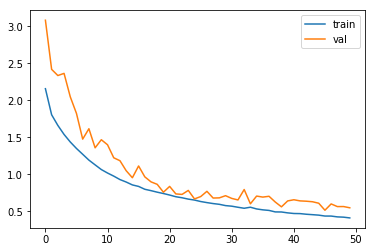

In [9]:
show_error_plot(train_loss, val_loss)

In [13]:
predicted_prob = data["predicted"]
predicted = [int(np.argmax(predicted_prob[i])) for i in range(len(predicted_prob))]
wanted = [int(y_test[i][0]) for i in range(len(y_test))]

In [85]:
def one_hot_encoded(labels, number_of_classes):
    labels = labels.astype(int)
    res = np.zeros((number_of_classes, labels.shape[0]))
    res[labels, np.arange(res.shape[1])] = 1
    return res

In [86]:
predictions=one_hot_encoded(np.array(predicted),10).T
labels=one_hot_encoded(np.array(wanted),10).T
from sklearn.metrics import roc_curve, auc
false_positive_rate = dict()
true_positive_rate = dict()
roc_auc = dict()
for i in range(10):
    false_positive_rate[i], true_positive_rate[i], _ = roc_curve(predictions[:, i], labels[:, i])
    roc_auc[i] = auc(false_positive_rate[i], true_positive_rate[i])

In [51]:
def get_class_name(index):
    if index == 0: return "airplane"
    if index == 1: return "automobile"
    if index == 2: return "bird"
    if index == 3: return "cat"
    if index == 4: return "deer"
    if index == 5: return "dog"
    if index == 6: return "frog"
    if index == 7: return "horse"
    if index == 8: return "ship"
    else: return "truck"

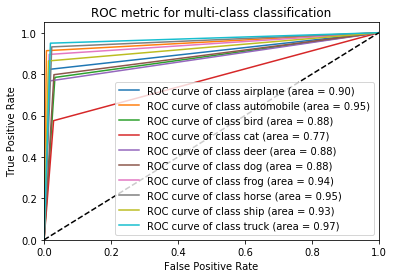

In [88]:
for i in range(10):
    plt.plot(false_positive_rate[i], true_positive_rate[i], label='ROC curve of class {0} (area = {1:0.2f})'
                                   ''.format(get_class_name(i), roc_auc[i]))


plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC metric for multi-class classification')
plt.legend(loc="lower right")
plt.show()

# ROC dla każdej wartości oddzielnie

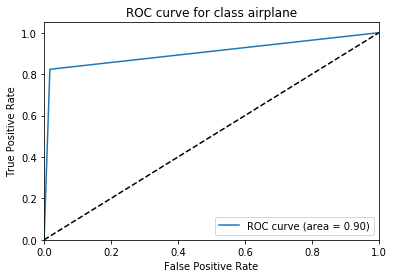

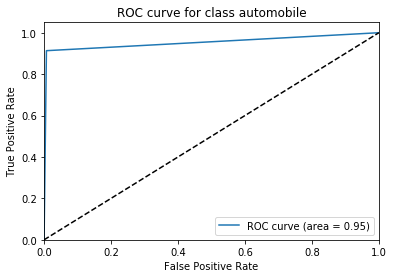

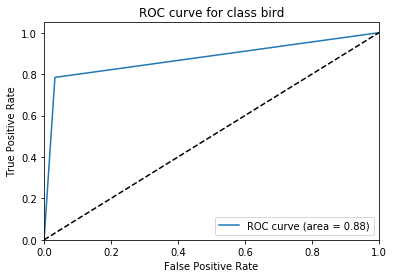

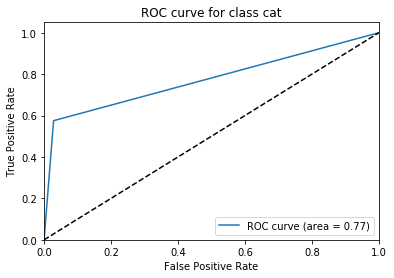

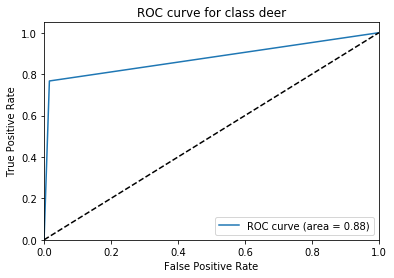

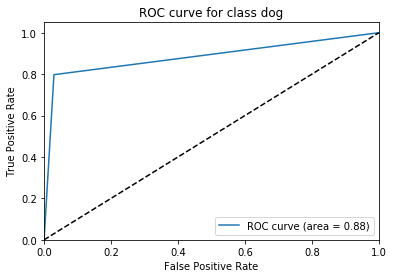

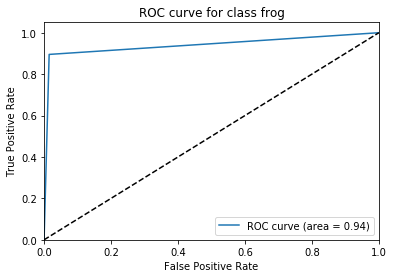

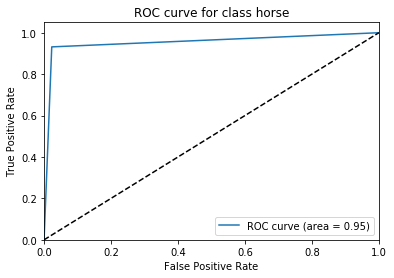

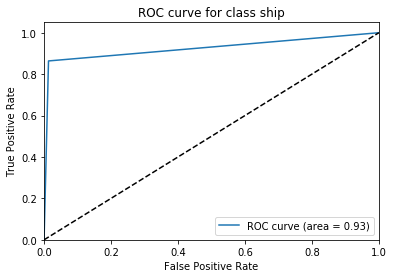

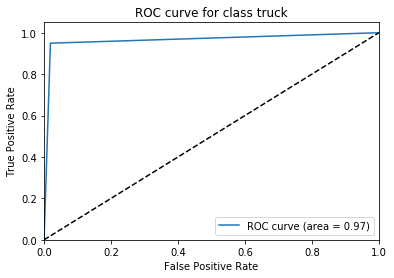

In [90]:
# wykres dla każdej z kategorii
for i in range(10):
    plt.figure()
    plt.plot(false_positive_rate[i], true_positive_rate[i], label='ROC curve (area = %0.2f)' % roc_auc[i])
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC curve for class {0}'.format(get_class_name(i)))
    plt.legend(loc="lower right")
plt.show()

# Macierz pomyłek

In [18]:
from sklearn.metrics import confusion_matrix
conf_matrix=confusion_matrix(np.array(predicted), np.array(wanted))
print(conf_matrix)

[[844   9  63  16   4   4   4  11  40  30]
 [  7 937   0   3   1   0   2   0  15  61]
 [ 34   2 705  39  33  33  25  20   4   4]
 [ 35   3  94 753  60 174  64  58  47  21]
 [ 16   1  71  40 859  31  24  68   2   8]
 [  0   2  24  99   7 732   8  44   1   1]
 [  3   2  31  27  18  10 863   3   3   4]
 [  5   1   5  11  12  15   3 790   0   6]
 [ 49  21   5   9   6   1   7   3 881  38]
 [  7  22   2   3   0   0   0   3   7 827]]


In [56]:
pd.DataFrame(conf_matrix)

,0,1,2,3,4,5,6,7,8,9
0,844,9,63,16,4,4,4,11,40,30
1,7,937,0,3,1,0,2,0,15,61
2,34,2,705,39,33,33,25,20,4,4
3,35,3,94,753,60,174,64,58,47,21
4,16,1,71,40,859,31,24,68,2,8
5,0,2,24,99,7,732,8,44,1,1
6,3,2,31,27,18,10,863,3,3,4
7,5,1,5,11,12,15,3,790,0,6
8,49,21,5,9,6,1,7,3,881,38
9,7,22,2,3,0,0,0,3,7,827




# Błędnie klasyfikowane wartości

/home/slowik/.local/lib/python3.5/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `toimage` is deprecated!
`toimage` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow's ``Image.fromarray`` directly instead.
  """


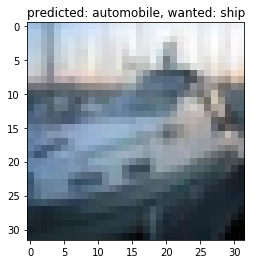

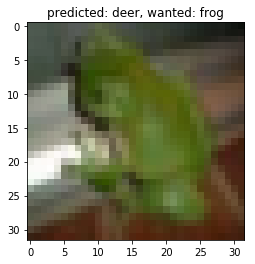

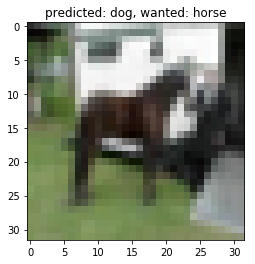

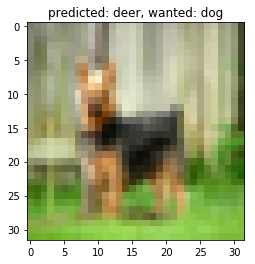

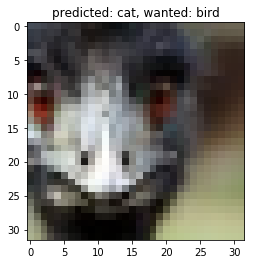

...

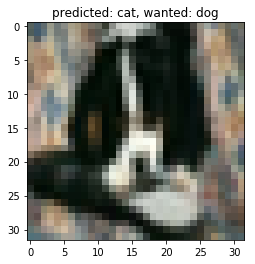

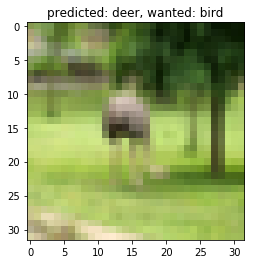

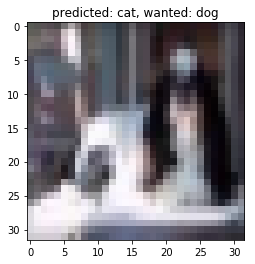

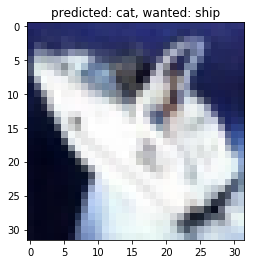

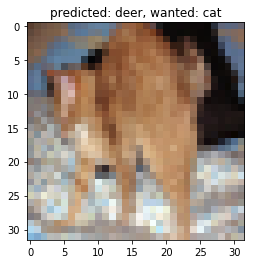

In [95]:
for i in range(len(y_test)):
    p = predicted[i]
    w = wanted[i]
    if p != w:
        pyplot.imshow(toimage(X_test[i]))
        pyplot.title("predicted: {0}, wanted: {1}".format(get_class_name(p), get_class_name(w)))
        plt.show()